In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
df = pd.read_excel("C:/Users/HP/Downloads/archive (3)/a_Dataset_CreditScoring.xlsx")

# Explore the dataset
print(df.info())

# Check for missing values
print(df.isnull().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000 entries, 0 to 2999
Data columns (total 30 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   TARGET           3000 non-null   int64  
 1   ID               3000 non-null   int64  
 2   DerogCnt         3000 non-null   int64  
 3   CollectCnt       3000 non-null   int64  
 4   BanruptcyInd     3000 non-null   int64  
 5   InqCnt06         3000 non-null   int64  
 6   InqTimeLast      2812 non-null   float64
 7   InqFinanceCnt24  3000 non-null   int64  
 8   TLTimeFirst      3000 non-null   int64  
 9   TLTimeLast       3000 non-null   int64  
 10  TLCnt03          3000 non-null   int64  
 11  TLCnt12          3000 non-null   int64  
 12  TLCnt24          3000 non-null   int64  
 13  TLCnt            2997 non-null   float64
 14  TLSum            2960 non-null   float64
 15  TLMaxSum         2960 non-null   float64
 16  TLSatCnt         2996 non-null   float64
 17  TLDel60Cnt    

In [2]:
df_cleaned = df.dropna()

In [3]:
df=df_cleaned
print(df.isnull().sum())

TARGET             0
ID                 0
DerogCnt           0
CollectCnt         0
BanruptcyInd       0
InqCnt06           0
InqTimeLast        0
InqFinanceCnt24    0
TLTimeFirst        0
TLTimeLast         0
TLCnt03            0
TLCnt12            0
TLCnt24            0
TLCnt              0
TLSum              0
TLMaxSum           0
TLSatCnt           0
TLDel60Cnt         0
TLBadCnt24         0
TL75UtilCnt        0
TL50UtilCnt        0
TLBalHCPct         0
TLSatPct           0
TLDel3060Cnt24     0
TLDel90Cnt24       0
TLDel60CntAll      0
TLOpenPct          0
TLBadDerogCnt      0
TLDel60Cnt24       0
TLOpen24Pct        0
dtype: int64


In [5]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
import lime
import lime.lime_tabular

# Prepare the data
X = df.drop(['TARGET', 'ID'], axis=1)  # Assuming 'ID' is not a predictive feature
y = df['TARGET']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a machine learning model (logistic regression for simplicity)
model = LogisticRegression()
model.fit(X_train, y_train)

# Evaluate the model
y_pred = model.predict(X_test)
print(classification_report(y_test, y_pred))

# Use LIME to explain individual predictions
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=X_train.columns, class_names=['Good Credit', 'Bad Credit'])

# Select an instance for explanation (you can choose any index from X_test)
instance_index = 0
instance = X_test.iloc[instance_index].values

# Explain the prediction for the selected instance
explanation = explainer.explain_instance(instance, model.predict_proba, num_features=len(X_train.columns))

# Visualize the explanation
explanation.show_in_notebook(show_table=True, show_all=False)


              precision    recall  f1-score   support

           0       0.82      0.99      0.90       444
           1       0.50      0.04      0.07       102

    accuracy                           0.81       546
   macro avg       0.66      0.52      0.48       546
weighted avg       0.76      0.81      0.74       546



C:\Users\HP\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\HP\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


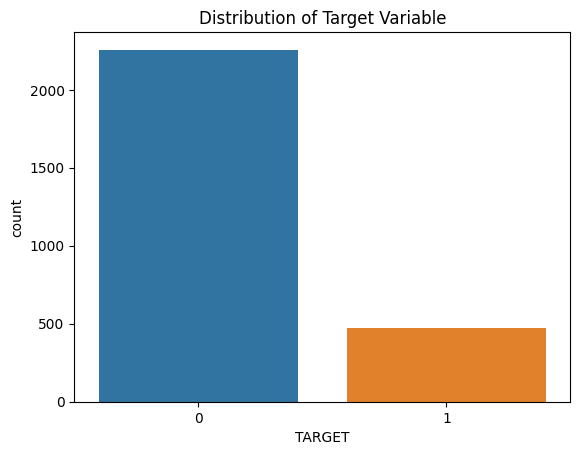

In [6]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.countplot(x='TARGET', data=df)
plt.title('Distribution of Target Variable')
plt.show()


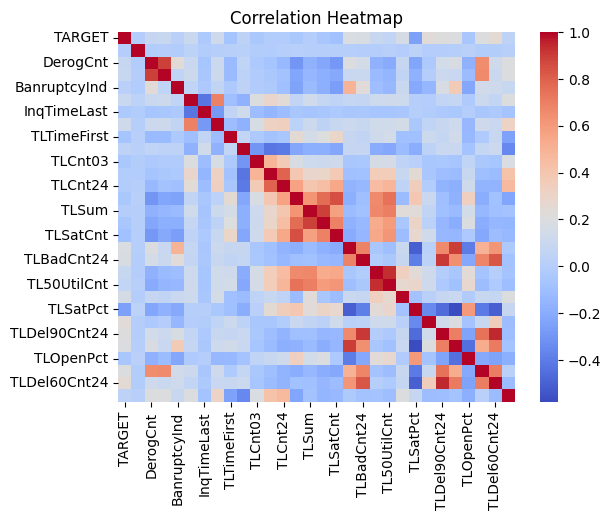

In [8]:
sns.heatmap(df.corr(), cmap='coolwarm', annot=False, fmt=".2f")
plt.title('Correlation Heatmap')
plt.show()


In [9]:
sns.pairplot(df, hue='TARGET', diag_kind='kde')
plt.suptitle('Pairplot of Features')
plt.show()


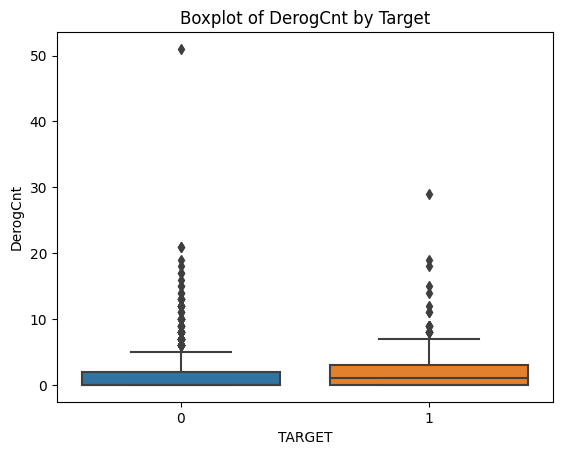

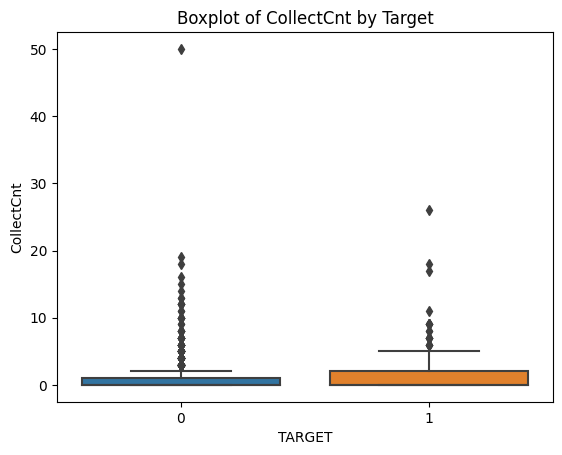

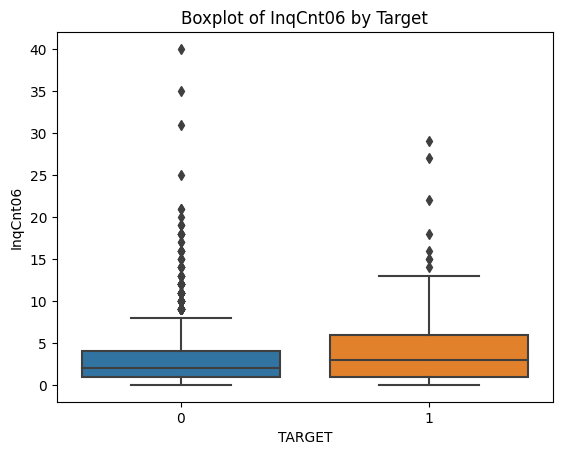

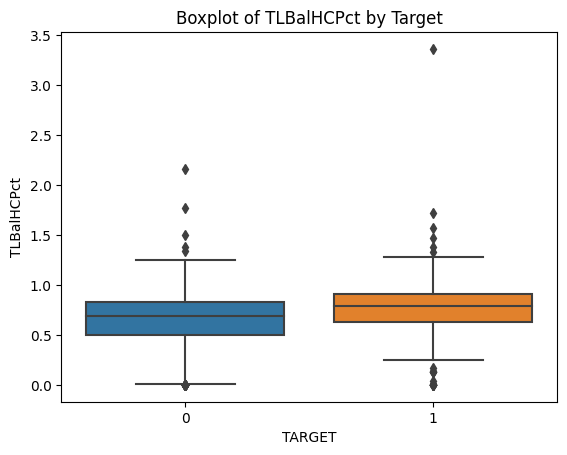

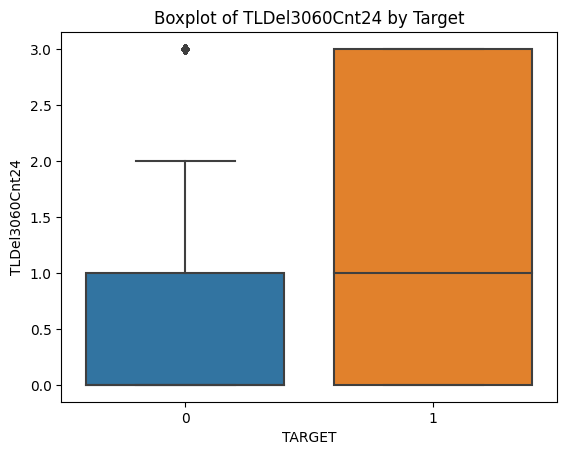

In [10]:
important_features = ['DerogCnt', 'CollectCnt', 'InqCnt06', 'TLBalHCPct', 'TLDel3060Cnt24']
for feature in important_features:
    sns.boxplot(x='TARGET', y=feature, data=df)
    plt.title(f'Boxplot of {feature} by Target')
    plt.show()


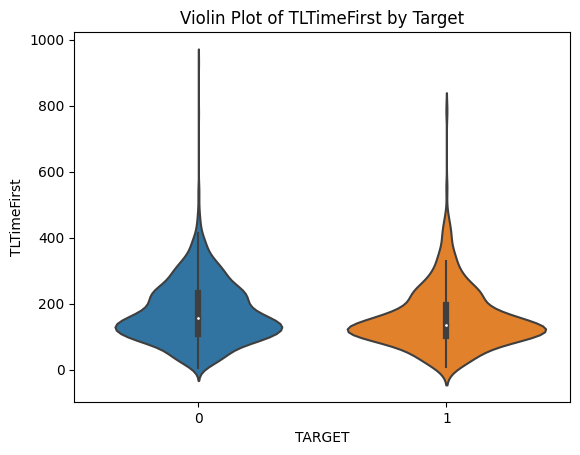

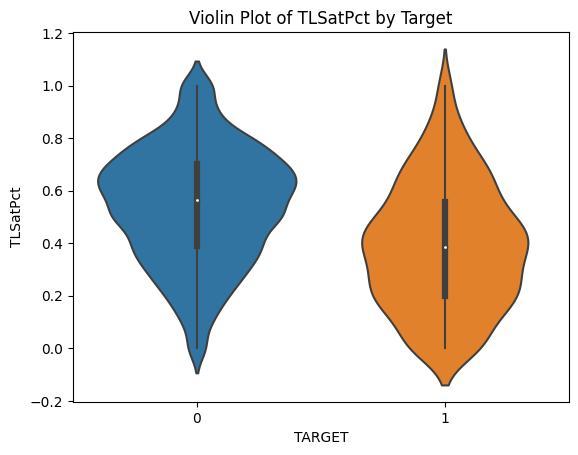

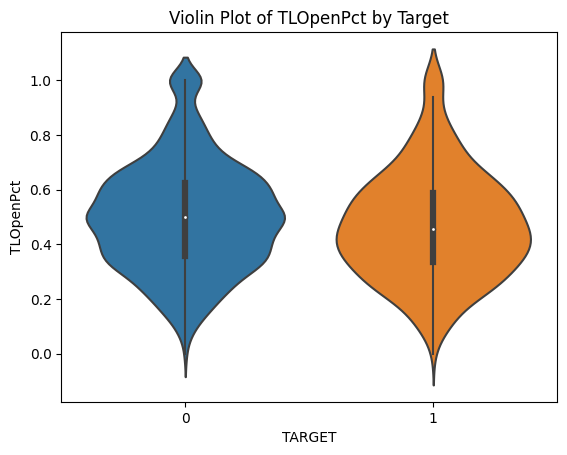

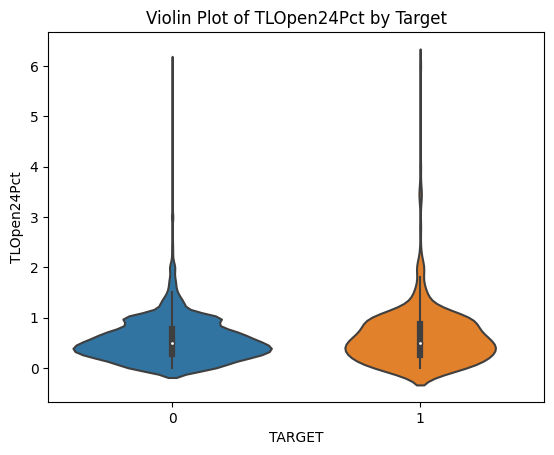

In [11]:
key_features = ['TLTimeFirst', 'TLSatPct', 'TLOpenPct', 'TLOpen24Pct']
for feature in key_features:
    sns.violinplot(x='TARGET', y=feature, data=df)
    plt.title(f'Violin Plot of {feature} by Target')
    plt.show()
